In [27]:
%matplotlib inline
import plotly.express as px
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import warnings
from collections import Counter
import sys

import os
from __future__ import division
plt.rcParams["figure.figsize"] = (20,10)
import tqdm as tqdm

import seaborn as sns


import igraph as ig
from igraph import plot

warnings.filterwarnings('ignore')
from IPython.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [2]:
from funciones import *

In [3]:
books = []
for i in range(5):
    books.append(pd.read_csv('data/asoiaf-book{}-edges.csv'.format(i+1)))

In [4]:
all_books = pd.concat(books)
all_books.head()

,Source,Target,Type,weight,book
0,Addam-Marbrand,Jaime-Lannister,Undirected,3,1.0
1,Addam-Marbrand,Tywin-Lannister,Undirected,6,1.0
2,Aegon-I-Targaryen,Daenerys-Targaryen,Undirected,5,1.0
3,Aegon-I-Targaryen,Eddard-Stark,Undirected,4,1.0
4,Aemon-Targaryen-(Maester-Aemon),Alliser-Thorne,Undirected,4,1.0


In [5]:
edges = all_books.groupby(['Source','Target']).agg({'weight':'sum'}).reset_index()
edges

GOT = nx.from_pandas_edgelist(edges, 
                            source='Source',
                            target='Target',
                            edge_attr='weight' )

In [6]:
print(info(GOT))

Tipo de grafo: <class 'networkx.classes.graph.Graph'>
Número de nodos: 796
Número de aristas: 2823
Es dirigido: False
Grado medio: 7.09
Grado máximo: 122
Densidad: 0.0089
Coeficiente de clustering promedio: 0.4859
Diámetro: 9



In [7]:
edges.sort_values('weight',ascending=False).head()

,Source,Target,weight
1334,Eddard-Stark,Robert-Baratheon,334
2031,Jon-Snow,Samwell-Tarly,228
1965,Joffrey-Baratheon,Sansa-Stark,222
1972,Joffrey-Baratheon,Tyrion-Lannister,219
640,Bran-Stark,Hodor,209


In [8]:
weighted_degrees = dict(nx.degree(GOT,weight='weight'))
max_degree = max(weighted_degrees.values())
min_degrre = min(weighted_degrees.values())

print(max_degree)
min_degrre

2873


3

In [9]:
grados = np.array(weighted_degrees.values())
grados

array(dict_values([56, 185, 2232, 101, 1569, 16, 1762, 196, 27, 192, 2873, 690, 609, 18, 1230, 1424, 19, 176, 41, 1608, 1649, 16, 91, 7, 1375, 6, 6, 136, 56, 10, 135, 31, 169, 54, 202, 4, 101, 169, 65, 46, 6, 395, 3, 48, 159, 187, 54, 88, 68, 6, 53, 59, 85, 154, 216, 265, 49, 196, 484, 2757, 3, 389, 55, 232, 1488, 934, 3, 19, 1460, 17, 782, 116, 151, 234, 15, 149, 23, 10, 4, 158, 6, 13, 4, 10, 14, 5, 215, 3, 184, 24, 470, 55, 521, 4, 3, 34, 199, 3, 4, 13, 8, 3, 7, 241, 112, 153, 196, 307, 59, 131, 401, 21, 85, 16, 313, 3, 11, 62, 26, 19, 1508, 9, 261, 25, 6, 203, 442, 41, 98, 39, 483, 19, 639, 207, 43, 44, 49, 85, 1547, 7, 13, 8, 23, 24, 12, 20, 47, 20, 166, 32, 71, 152, 42, 7, 4, 24, 327, 17, 28, 40, 10, 7, 20, 149, 105, 56, 154, 238, 410, 195, 268, 298, 151, 171, 232, 528, 143, 73, 120, 7, 246, 11, 44, 3, 37, 189, 63, 264, 33, 57, 81, 166, 44, 7, 155, 15, 85, 44, 21, 22, 13, 21, 733, 23, 40, 43, 23, 100, 45, 5, 11, 118, 76, 96, 27, 203, 24, 68, 13, 3, 34, 8, 8, 7, 3, 20, 3, 17, 89, 3

In [10]:
deg = np.array([56, 185, 2232, 101, 1569, 16, 1762, 196, 27, 192, 2873, 690, 609, 18, 1230, 1424, 19, 176, 41, 1608, 1649, 16, 91, 7, 1375, 6, 6, 136, 56, 10, 135, 31, 169, 54, 202, 4, 101, 169, 65, 46, 6, 395, 3, 48, 159, 187, 54, 88, 68, 6, 53, 59, 85, 154, 216, 265, 49, 196, 484, 2757, 3, 389, 55, 232, 1488, 934, 3, 19, 1460, 17, 782, 116, 151, 234, 15, 149, 23, 10, 4, 158, 6, 13, 4, 10, 14, 5, 215, 3, 184, 24, 470, 55, 521, 4, 3, 34, 199, 3, 4, 13, 8, 3, 7, 241, 112, 153, 196, 307, 59, 131, 401, 21, 85, 16, 313, 3, 11, 62, 26, 19, 1508, 9, 261, 25, 6, 203, 442, 41, 98, 39, 483, 19, 639, 207, 43, 44, 49, 85, 1547, 7, 13, 8, 23, 24, 12, 20, 47, 20, 166, 32, 71, 152, 42, 7, 4, 24, 327, 17, 28, 40, 10, 7, 20, 149, 105, 56, 154, 238, 410, 195, 268, 298, 151, 171, 232, 528, 143, 73, 120, 7, 246, 11, 44, 3, 37, 189, 63, 264, 33, 57, 81, 166, 44, 7, 155, 15, 85, 44, 21, 22, 13, 21, 733, 23, 40, 43, 23, 100, 45, 5, 11, 118, 76, 96, 27, 203, 24, 68, 13, 3, 34, 8, 8, 7, 3, 20, 3, 17, 89, 3, 14, 12, 60, 101, 3, 90, 138, 183, 19, 24, 12, 7, 3, 67, 3, 125, 47, 15, 16, 11, 7, 4, 45, 64, 112, 30, 8, 99, 4, 9, 145, 65, 4, 3, 7, 345, 253, 77, 43, 8, 8, 117, 539, 6, 28, 33, 27, 49, 18, 6, 15, 34, 29, 17, 21, 16, 12, 30, 3, 6, 3, 24, 22, 32, 3, 37, 42, 329, 43, 34, 14, 74, 68, 6, 5, 165, 14, 23, 4, 159, 24, 34, 149, 57, 218, 16, 55, 37, 8, 63, 14, 57, 12, 34, 292, 28, 3, 121, 357, 49, 135, 9, 3, 42, 4, 4, 18, 193, 18, 22, 220, 26, 12, 9, 9, 92, 16, 18, 39, 7, 24, 16, 13, 11, 10, 30, 376, 34, 19, 11, 11, 6, 3, 3, 23, 9, 127, 19, 4, 48, 22, 81, 180, 10, 17, 7, 12, 20, 28, 3, 46, 383, 6, 20, 102, 7, 11, 291, 117, 3, 7, 7, 14, 7, 26, 52, 6, 3, 40, 12, 147, 3, 4, 86, 27, 39, 103, 291, 11, 14, 59, 23, 4, 341, 47, 14, 22, 13, 4, 34, 22, 23, 34, 8, 16, 55, 51, 64, 70, 29, 37, 28, 15, 19, 21, 6, 12, 18, 25, 44, 90, 58, 64, 5, 39, 10, 55, 3, 24, 3, 43, 3, 4, 3, 30, 9, 11, 30, 3, 9, 12, 49, 50, 27, 32, 5, 35, 3, 34, 3, 16, 151, 12, 43, 25, 19, 15, 28, 16, 3, 41, 44, 3, 24, 76, 31, 22, 8, 3, 15, 26, 36, 25, 6, 7, 14, 27, 12, 105, 43, 9, 37, 10, 16, 30, 44, 7, 15, 21, 13, 6, 9, 46, 29, 45, 68, 21, 28, 20, 5, 3, 10, 56, 7, 84, 23, 77, 8, 10, 4, 3, 24, 9, 9, 6, 54, 8, 3, 3, 3, 7, 7, 10, 66, 14, 24, 16, 21, 11, 5, 8, 4, 3, 13, 26, 51, 125, 26, 13, 25, 34, 9, 9, 4, 6, 11, 55, 7, 9, 7, 3, 11, 7, 8, 3, 24, 19, 3, 3, 8, 7, 3, 10, 9, 30, 40, 3, 6, 9, 6, 18, 5, 3, 26, 12, 4, 5, 3, 4, 12, 7, 4, 4, 7, 15, 3, 34, 3, 6, 24, 3, 13, 15, 14, 15, 99, 16, 7, 24, 7, 3, 6, 11, 8, 4, 9, 23, 9, 3, 29, 30, 5, 3, 3, 11, 11, 6, 6, 6, 3, 3, 12, 9, 8, 3, 15, 3, 13, 3, 29, 41, 68, 31, 3, 7, 8, 8, 4, 8, 3, 37, 10, 23, 3, 39, 129, 24, 3, 13, 5, 8, 5, 7, 10, 27, 4, 4, 16, 7, 3, 3, 5, 3, 3, 12, 23, 3, 3, 22, 6, 7, 3, 24, 11, 6, 14, 6, 14, 15, 4, 20, 4, 10, 3, 3, 9, 5, 20, 29, 3, 4, 18, 3, 28, 3, 9, 9, 6, 28, 10, 10, 11, 10, 3, 12, 15, 5, 4, 3, 4, 13, 3, 3, 6, 6, 6, 3, 3, 3, 17, 7, 7, 4, 4, 6, 3, 11, 20, 4, 4, 13, 17, 3, 48, 6, 3, 16, 9, 6, 4, 9, 4, 17, 9, 8, 6, 3, 3, 8, 22, 7, 15, 7, 4, 6, 3, 6, 5, 3, 7, 3, 7, 3, 12, 3, 4, 4, 3, 6, 3, 6, 10, 4, 7, 6, 3])


fig = px.histogram(deg, nbins = 50)
fig.show(scale = 'log-log')

In [11]:
b = px.box(weighted_degrees.values())
b.show()

In [12]:
n = len(weighted_degrees.values())
print(n)
x = []
for i in range(1,n+1):
    x.append(i)
    
sp = px.scatter(x, weighted_degrees.values())
sp.show()

796


In [13]:
subG = GOT.subgraph([n for n in weighted_degrees if weighted_degrees[n]>200])

In [14]:
print(info(subG))

Tipo de grafo: <class 'networkx.classes.graph.Graph'>
Número de nodos: 63
Número de aristas: 496
Es dirigido: False
Grado medio: 15.75
Grado máximo: 40
Densidad: 0.2540
Coeficiente de clustering promedio: 0.6421
Diámetro: 4



In [48]:
# Crear un nuevo grafo no ponderado
G_unweighted = nx.Graph()

# Agregar los nodos y aristas, ignorando los pesos
for u, v in GOT.edges():
    G_unweighted.add_edge(u, v)


In [ ]:
print(G_unweighted.edges(data=True))

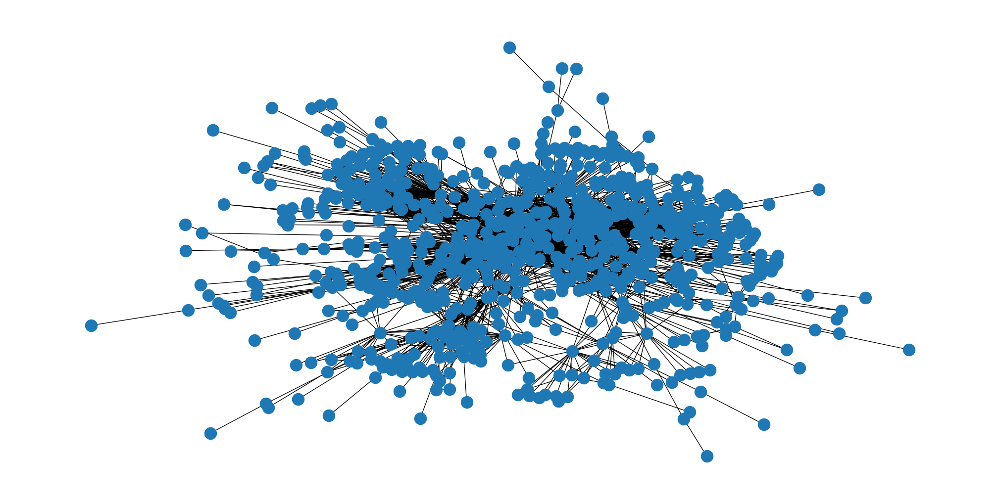

In [49]:
nx.draw(G_unweighted)

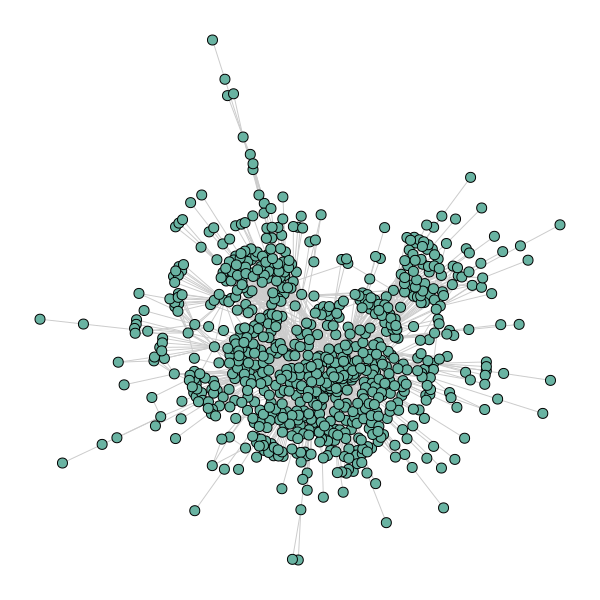

In [50]:


# Convertir desde NetworkX (G_unweighted)
G_ig = ig.Graph.TupleList(G_unweighted.edges(), directed=False)

# Quitar etiquetas (nombres de los nodos)
G_ig.vs["label"] = None

# Personalizar estilo de visualización
visual_style = {
    "layout": G_ig.layout("fr"),      # Fruchterman-Reingold layout
    "vertex_size": 10,                # Tamaño de los nodos
    "vertex_color": "#69b3a2",        # Color de los nodos
    "edge_color": "#cccccc",          # Color de las aristas
    "bbox": (600, 600),               # Tamaño del gráfico
    "margin": 40                      # Margen
}

# Graficar
plot(G_ig, **visual_style)


In [ ]:
for node, degree in G_unweighted.degree():
    print(f"{node}: {degree}")

In [51]:
print(info(G_unweighted))

Tipo de grafo: <class 'networkx.classes.graph.Graph'>
Número de nodos: 796
Número de aristas: 2823
Es dirigido: False
Grado medio: 7.09
Grado máximo: 122
Densidad: 0.0089
Coeficiente de clustering promedio: 0.4859
Diámetro: 9



In [75]:
import igraph as ig
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
from matplotlib.colors import Normalize

def graficar_centralidad_igraph(G_ig, centrality, titulo="Centralidad", layout="fr"):
    """
    Visualiza centralidad usando igraph con mejor calidad visual
    
    Parameters:
    -----------
    G_ig : igraph.Graph
        El grafo de igraph
    centrality : dict, list o array
        Valores de centralidad para cada nodo
    titulo : str
        Título del gráfico
    layout : str
        Algoritmo de layout ('fr', 'kk', 'circle', 'grid', 'random', 'drl')
    """
    # Convertir centralidad a array
    if isinstance(centrality, dict):
        cent_values = np.array(list(centrality.values()))
    else:
        cent_values = np.array(centrality)
    
    # Crear layout
    if layout == "fr":
        pos = G_ig.layout_fruchterman_reingold(niter=500)
    elif layout == "kk":
        pos = G_ig.layout_kamada_kawai()
    elif layout == "circle":
        pos = G_ig.layout_circle()
    elif layout == "grid":
        pos = G_ig.layout_grid()
    elif layout == "drl":
        pos = G_ig.layout_drl()
    else:
        pos = G_ig.layout_auto()
    
    # Configurar tamaños y colores
    if len(np.unique(cent_values)) == 1:
        vertex_sizes = [30] * len(cent_values)
        colors = [0.5] * len(cent_values)
        vmin = vmax = cent_values[0]
    else:
        min_val, max_val = cent_values.min(), cent_values.max()
        # Tamaños de nodos (15-60)
        vertex_sizes = 15 + 45 * (cent_values - min_val) / (max_val - min_val)
        colors = (cent_values - min_val) / (max_val - min_val)
        vmin, vmax = min_val, max_val
    
    # Crear figura
    fig, ax = plt.subplots(figsize=(12, 10), facecolor='white')
    
    # Configurar colormap
    cmap = cm.plasma
    norm = Normalize(vmin=vmin, vmax=vmax)
    
    # Dibujar el grafo
    ig.plot(G_ig, 
            target=ax,
            layout=pos,
            vertex_size=vertex_sizes,
            vertex_color=[cmap(norm(c)) for c in colors],
            vertex_frame_width=1,
            vertex_frame_color="white",
            edge_width=1.5,
            edge_color="rgba(100,100,100,0.3)",
            edge_curved=0.1,
            margin=50)
    
    # Título
    ax.set_title(titulo, fontsize=16, fontweight='bold', pad=20)
    ax.axis('off')
    
    plt.tight_layout()
    plt.show()
    
    # Estadísticas
    print(f"\n📊 Estadísticas de {titulo}:")
    print(f"   Mínimo: {cent_values.min():.4f}")
    print(f"   Máximo: {cent_values.max():.4f}")
    print(f"   Promedio: {cent_values.mean():.4f}")
    print(f"   Desv. estándar: {cent_values.std():.4f}")

def convertir_nx_a_igraph(G_nx):
    """
    Convierte un grafo de NetworkX a igraph
    """
    # Obtener lista de aristas
    edges = list(G_nx.edges())
    
    # Crear grafo igraph
    G_ig = ig.Graph()
    G_ig.add_vertices(len(G_nx.nodes()))
    
    # Mapear nodos si no son secuenciales
    node_to_id = {node: i for i, node in enumerate(G_nx.nodes())}
    edge_list = [(node_to_id[u], node_to_id[v]) for u, v in edges]
    
    G_ig.add_edges(edge_list)
    G_ig.vs['name'] = list(G_nx.nodes())
    
    return G_ig, node_to_id

def graficar_centralidad_premium(G_nx, centrality, titulo="Centralidad", layout="fr"):
    """
    Versión premium que convierte automáticamente de NetworkX a igraph
    
    Parameters:
    -----------
    G_nx : networkx.Graph
        Grafo de NetworkX
    centrality : dict, list o array
        Valores de centralidad
    titulo : str
        Título del gráfico
    layout : str
        Algoritmo de layout
    """
    # Convertir a igraph
    G_ig, node_mapping = convertir_nx_a_igraph(G_nx)
    
    # Si centrality es dict con nombres de nodos, reordenar
    if isinstance(centrality, dict):
        cent_ordenada = [centrality[node] for node in G_nx.nodes()]
    else:
        cent_ordenada = centrality
    
    # Usar la función de igraph
    graficar_centralidad_igraph(G_ig, cent_ordenada, titulo, layout)

def comparar_centralidades_igraph(G_nx, centralidades_dict, layouts=None):
    """
    Compara múltiples centralidades usando igraph con layouts personalizados
    
    Parameters:
    -----------
    G_nx : networkx.Graph
        Grafo de NetworkX
    centralidades_dict : dict
        Diccionario con tipo de centralidad como clave
    layouts : list o None
        Lista de layouts para cada subplot, o None para usar 'fr' en todos
    """
    n_plots = len(centralidades_dict)
    cols = min(3, n_plots)
    rows = (n_plots - 1) // cols + 1
    
    if layouts is None:
        layouts = ['fr'] * n_plots
    
    # Convertir a igraph una sola vez
    G_ig, node_mapping = convertir_nx_a_igraph(G_nx)
    
    fig, axes = plt.subplots(rows, cols, figsize=(6*cols, 5*rows), facecolor='white')
    if n_plots == 1:
        axes = [axes]
    elif rows == 1:
        axes = list(axes) if hasattr(axes, '__iter__') else [axes]
    else:
        axes = axes.flatten()
    
    for i, ((tipo, centrality), layout) in enumerate(zip(centralidades_dict.items(), layouts)):
        ax = axes[i]
        
        # Preparar datos
        if isinstance(centrality, dict):
            cent_values = np.array([centrality[node] for node in G_nx.nodes()])
        else:
            cent_values = np.array(centrality)
        
        # Layout
        if layout == "fr":
            pos = G_ig.layout_fruchterman_reingold(niter=300)
        elif layout == "kk":
            pos = G_ig.layout_kamada_kawai()
        elif layout == "circle":
            pos = G_ig.layout_circle()
        else:
            pos = G_ig.layout_auto()
        
        # Colores y tamaños
        if len(np.unique(cent_values)) == 1:
            vertex_sizes = [25] * len(cent_values)
            colors = [0.5] * len(cent_values)
            vmin = vmax = cent_values[0]
        else:
            min_val, max_val = cent_values.min(), cent_values.max()
            vertex_sizes = 10 + 30 * (cent_values - min_val) / (max_val - min_val)
            colors = (cent_values - min_val) / (max_val - min_val)
            vmin, vmax = min_val, max_val
        
        # Colormap diferente para cada tipo
        cmaps = ['plasma', 'viridis', 'coolwarm', 'magma', 'inferno']
        cmap = getattr(cm, cmaps[i % len(cmaps)])
        norm = Normalize(vmin=vmin, vmax=vmax)
        
        # Dibujar
        ig.plot(G_ig,
                target=ax,
                layout=pos,
                vertex_size=vertex_sizes,
                vertex_color=[cmap(norm(c)) for c in colors],
                vertex_frame_width=0.5,
                vertex_frame_color="white",
                edge_width=1,
                edge_color="rgba(150,150,150,0.4)",
                edge_curved=0.05,
                margin=30)
        
        ax.set_title(f'{tipo.capitalize()} Centrality', fontsize=12, fontweight='bold')
        ax.axis('off')
    
    # Ocultar subplots vacíos
    for i in range(n_plots, len(axes)):
        axes[i].set_visible(False)
    
    plt.tight_layout()
    plt.show()

# Función de conveniencia con estilos predefinidos
def graficar_estilo_moderno(G_nx, centrality, estilo="neon"):
    """
    Estilos predefinidos modernos
    
    Estilos disponibles: 'neon', 'pastel', 'dark', 'academic'
    """
    G_ig, _ = convertir_nx_a_igraph(G_nx)
    
    if isinstance(centrality, dict):
        cent_values = np.array([centrality[node] for node in G_nx.nodes()])
    else:
        cent_values = np.array(centrality)
    
    # Configuraciones por estilo
    estilos = {
        'neon': {
            'facecolor': 'black',
            'cmap': cm.plasma,
            'edge_color': 'rgba(0,255,255,0.3)',
            'vertex_frame_color': 'cyan'
        },
        'pastel': {
            'facecolor': '#f8f9fa',
            'cmap': cm.Set3,
            'edge_color': 'rgba(200,200,200,0.5)',
            'vertex_frame_color': 'white'
        },
        'dark': {
            'facecolor': '#2c3e50',
            'cmap': cm.viridis,
            'edge_color': 'rgba(255,255,255,0.2)',
            'vertex_frame_color': 'white'
        },
        'academic': {
            'facecolor': 'white',
            'cmap': cm.Blues,
            'edge_color': 'rgba(100,100,100,0.6)',
            'vertex_frame_color': 'navy'
        }
    }
    
    config = estilos.get(estilo, estilos['neon'])
    
    # Preparar datos
    min_val, max_val = cent_values.min(), cent_values.max()
    if max_val > min_val:
        vertex_sizes = 20 + 40 * (cent_values - min_val) / (max_val - min_val)
        colors = (cent_values - min_val) / (max_val - min_val)
    else:
        vertex_sizes = [30] * len(cent_values)
        colors = [0.5] * len(cent_values)
    
    # Crear figura
    fig, ax = plt.subplots(figsize=(12, 10), facecolor=config['facecolor'])
    
    # Layout
    pos = G_ig.layout_fruchterman_reingold(niter=500)
    
    # Dibujar
    ig.plot(G_ig,
            target=ax,
            layout=pos,
            vertex_size=vertex_sizes,
            vertex_color=[config['cmap'](c) for c in colors],
            vertex_frame_width=2,
            vertex_frame_color=config['vertex_frame_color'],
            edge_width=2,
            edge_color=config['edge_color'],
            edge_curved=0.1,
            margin=60)
    
    ax.set_title(f'Centralidad - Estilo {estilo.capitalize()}', 
                fontsize=16, fontweight='bold', 
                color='white' if config['facecolor'] != 'white' else 'black')
    ax.axis('off')
    
    plt.tight_layout()
    plt.show()

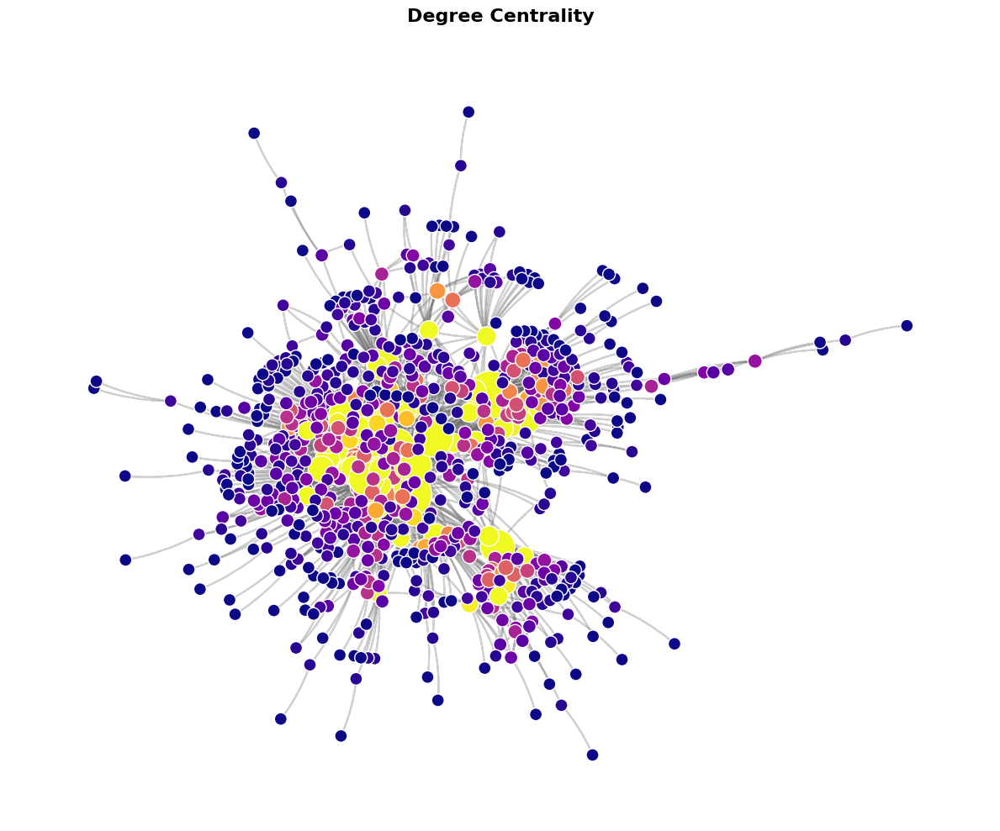


📊 Estadísticas de Degree Centrality:
   Mínimo: 0.0013
   Máximo: 0.1535
   Promedio: 0.0089
   Desv. estándar: 0.0159


In [81]:
# Uso directo con tu grafo de NetworkX
graficar_centralidad_premium(G_unweighted, degree_centrality, "Degree Centrality")

In [96]:
grados = grados = [grado for _, grado in G_unweighted.degree()]

In [106]:
degree_centrality = nx.degree_centrality(G_unweighted)

In [108]:
katz_centarlity = nx.katz_centrality(G_unweighted, alpha=0.1, beta=1.0, max_iter=1000, tol=1e-06, nstart=None, normalized=True, weight=None)

PowerIterationFailedConvergence: (PowerIterationFailedConvergence(...), 'power iteration failed to converge within 1000 iterations')

In [104]:
eigenvector = nx.eigenvector_centrality(G_unweighted)

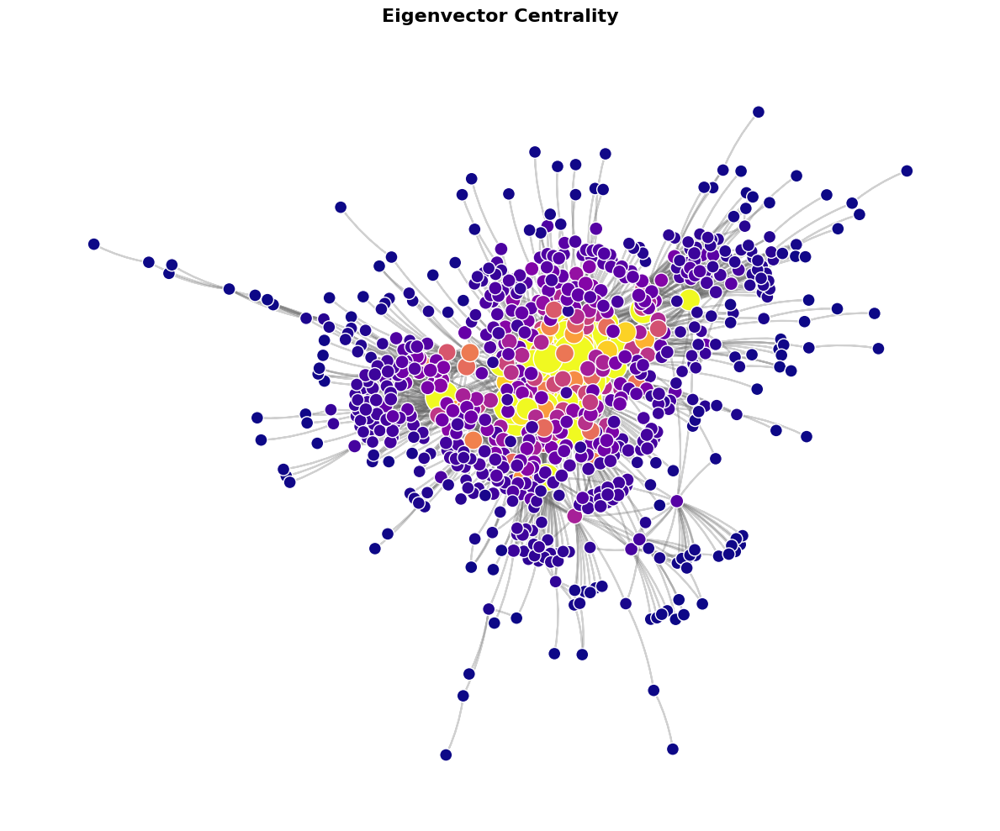


📊 Estadísticas de Eigenvector Centrality:
   Mínimo: 0.0000
   Máximo: 0.2516
   Promedio: 0.0168
   Desv. estándar: 0.0312


In [105]:
graficar_centralidad_premium(G_unweighted, eigenvector, "Eigenvector Centrality")

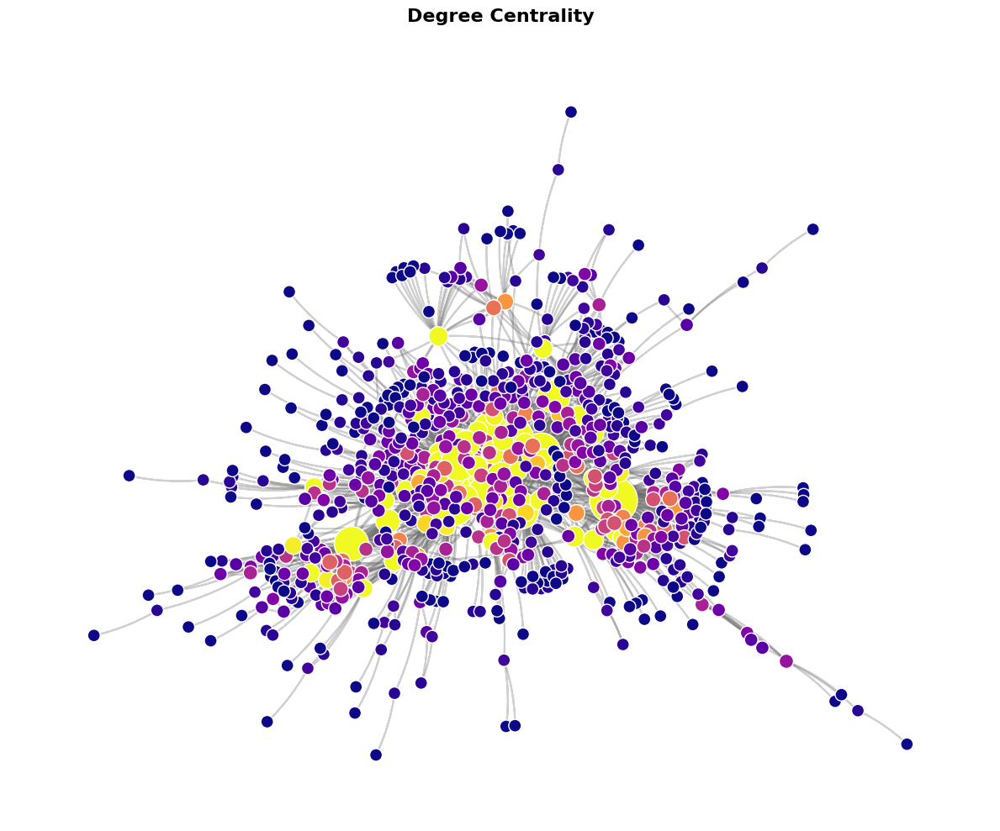


📊 Estadísticas de Degree Centrality:
   Mínimo: 0.0013
   Máximo: 0.1535
   Promedio: 0.0089
   Desv. estándar: 0.0159


In [107]:
graficar_centralidad_premium(G_unweighted, degree_centrality, "Degree Centrality")

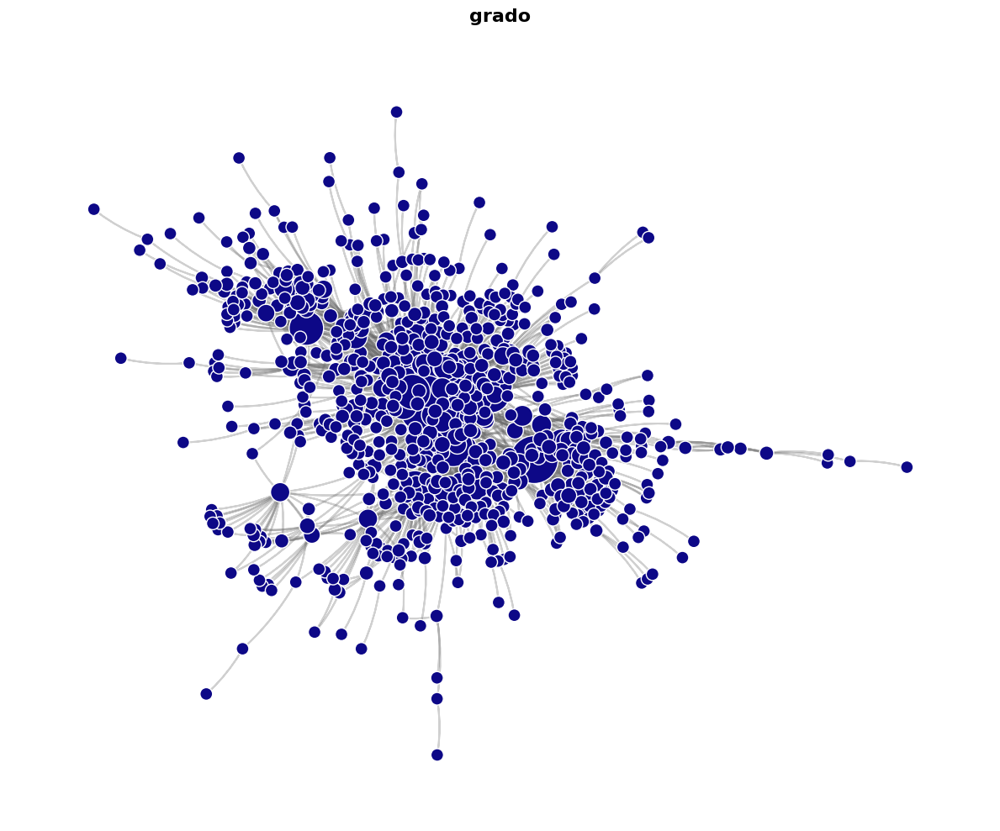


📊 Estadísticas de grado:
   Mínimo: 1.0000
   Máximo: 122.0000
   Promedio: 7.0930
   Desv. estándar: 12.6766


In [100]:
graficar_centralidad_premium(G_unweighted, grados, "grado")